#1. Darknet clone
Runtime ==> GPU

In [ ]:
# clone darknet repo
!git clone https://github.com/AlexeyAB/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 15308, done.
remote: Total 15308 (delta 0), reused 0 (delta 0), pack-reused 15308
Receiving objects: 100% (15308/15308), 13.70 MiB | 17.76 MiB/s, done.
Resolving deltas: 100% (10402/10402), done.


In [ ]:
%cd darknet

/content/darknet


In [ ]:
!ls -al

total 268
drwxr-xr-x 14 root root  4096 Sep 14 15:21 .
drwxr-xr-x  1 root root  4096 Sep 14 15:21 ..
drwxr-xr-x  4 root root  4096 Sep 14 15:21 3rdparty
drwxr-xr-x  3 root root  4096 Sep 14 15:21 build
-rwxr-xr-x  1 root root 27008 Sep 14 15:21 build.ps1
drwxr-xr-x  3 root root  4096 Sep 14 15:21 cfg
drwxr-xr-x  2 root root  4096 Sep 14 15:21 .circleci
drwxr-xr-x  3 root root  4096 Sep 14 15:21 cmake
-rw-r--r--  1 root root 24576 Sep 14 15:21 CMakeLists.txt
-rw-r--r--  1 root root  1406 Sep 14 15:21 DarknetConfig.cmake.in
-rw-r--r--  1 root root  9469 Sep 14 15:21 darknet_images.py
-rw-r--r--  1 root root 10828 Sep 14 15:21 darknet.py
-rw-r--r--  1 root root  6747 Sep 14 15:21 darknet_video.py
drwxr-xr-x  3 root root  4096 Sep 14 15:21 data
drwxr-xr-x  8 root root  4096 Sep 14 15:21 .git
drwxr-xr-x  4 root root  4096 Sep 14 15:21 .github
-rw-r--r--  1 root root   686 Sep 14 15:21 .gitignore
-rwxr-xr-x  1 root root   110 Sep 14 15:21 image_yolov3.sh
-rwxr-xr-x  1 root root   110 Sep 14 

In [ ]:
# change makefile to have GPU,OPENCV, CUDNN enabled
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile

In [ ]:
#Compile Darknet
!make

In [ ]:
# get yolov3 pretrained coco dataset weights
!wget https://pjreddie.com/media/files/yolov3.weights

--2021-09-14 15:24:36--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236.52M  69.1MB/s    in 3.7s    

2021-09-14 15:24:39 (64.7 MB/s) - ‘yolov3.weights’ saved [248007048/248007048]



#2. OpenCV Yolo Video

In [ ]:
import cv2
import IPython
import numpy as np
import time
import math
from google.colab.patches import cv2_imshow

In [ ]:
min_confidence = 0.5
weight_file = 'yolov3.weights'
cfg_file = 'cfg/yolov3.cfg'
name_file = 'data/coco.names'

file_name = 'highway_road.png'

In [ ]:
# Load YOLO
net = cv2.dnn.readNet(weight_file, cfg_file)

In [ ]:
classes = []
with open(name_file, 'r') as f:
    classes = [line.strip() for line in f.readlines()]
print(classes)

['person', 'bicycle', 'car', 'motorbike', 'aeroplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'sofa', 'pottedplant', 'bed', 'diningtable', 'toilet', 'tvmonitor', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


In [ ]:
layer_names = net.getLayerNames()
output_layers = [layer_names[i[0] - 1] for i in net.getUnconnectedOutLayers()]

In [ ]:
from google.colab import files
files.upload()

Saving highway_road.png to highway_road.png


{'highway_road.png': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\r \x00\x00\x07Z\x08\x06\x00\x00\x00\xd7\xf0\'\xda\x00\x00\x0cgiCCPICC Profile\x00\x00H\x89\x95W\x07XS\xc9\x16\x9e[\x92\x90\x90\xd0\x02\x11\x90\x12z\x13\xa4W)!\xb4\x08\x02R\x05\x1b!\t$\x94\x18\x13\x82\x8a\xbd,*\xb8v\x11\xc5\x8a\xae\x8a(\xba\x16@\x16\x15\xb1\x97E\xb1\xf7E\x11\x15e],(\x8a\xca\x9b\x14\xd0u_\xf9\xde\xf9\xbe\xb9\xf3\xe7\xcc\x99\xff\x94\xcc\xdc;\x03\x80v/W"\xc9Cu\x00\xc8\x17\x17H\x13"C\x99c\xd2\xd2\x99\xa4\x0e@\x044\xa0\x07\x9b\x03\x97\'\x93\xb0\xe2\xe3c\x00\x94\x81\xfe\xef\xf2\xfe&@\x14\xfd5g\x05\xd7?\xc7\xff\xab\xe8\xf1\x052\x1e\x00\xc88\x883\xf92^>\xc4M\x00\xe0\x1bx\x12i\x01\x00D\x85\xdejJ\x81D\x81\xe7@\xac/\x85\x01B\xbcZ\x81\xb3Ux\x97\x02g\xaap\xa3\xd2&)\x81\r\xf1\x15\x004\xa8\\\xae4\x1b\x00\xad\xfbP\xcf,\xe4eC\x1e\xad\xcf\x10\xbb\x8a\xf9"1\x00\xda\xc3 \x0e\xe2\t\xb9|\x88\x15\xb1\x0f\xcb\xcf\x9f\xa4\xc0\xe5\x10\xdbC{\t\xc40\x1e\xe0\x9b\xf9\x1dg\xf6\xdf\xf83\x07\xf9\xb9\xdc\xecA\xac\xcaK)\x1aa"\x99$\x8f;\xe

In [ ]:
def detectAndLane(frame):

    height, width, channedls = frame.shape
    # Detecting objects
    # https://docs.opencv.org/master/d6/d0f/group__dnn.html
    blob = cv2.dnn.blobFromImage(frame, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    class_ids = []
    confidences = []
    boxes = []

    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            # Filter only car(2)
            if (confidence > min_confidence):
                # Object detected
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    # Region of Interest
    mask = np.zeros((height, width), dtype='uint8')
    poly_heigh = int(0.72 * height)
    poly_left = int(0.47 * width)
    poly_right = int(0.53 * width)
    poly_bottom = int(0.94 * height)
    poly_right_bottom = int(0.90 * width)
    poly_left_bottom = int(0.10 * width)
    roi_left = int(0.3 * width)
    roi_right = int(0.60 * width)
    polygons = np.array([[(poly_left_bottom, poly_bottom), (poly_left, poly_heigh), (poly_right, poly_heigh), (poly_right_bottom, poly_bottom)]])
    cv2.fillPoly(mask, polygons, 255)
    #cv2_imshow(mask)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, min_confidence, 0.4)
    font = cv2.FONT_HERSHEY_COMPLEX
    margin = 5
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            label = str(classes[class_ids[i]])
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0,255,0), 2)
            cv2.putText(frame, label, (x, y + 30), font, 0.5, (0, 255, 0), 1) 
            # Bitwise operation between box and mask 
            box = np.array([[(x-margin, y+h+margin), (x-margin, y-margin), (x+w+margin, y), (x+w+margin, y+h+margin)]])
            cv2.fillPoly(mask, box, 0)             
    cv2_imshow(mask)

    # Lane Detection
    gray = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)
    # GaussianBlur for refucing noise
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    canny = cv2.Canny(blur, 40, 130)

    # Bitwise operation between poly and mask
    masked = cv2.bitwise_and(canny, mask)
    # Lane Detection
    lines = cv2.HoughLinesP(masked, 2, np.pi / 180, 20, np.array([]), 20, 10)
    if lines is not None:
        for line in lines:
            for x1, y1, x2, y2 in line:
                cv2.line(frame, (x1,y1), (x2,y2), (0,  255, 255), 5)

    cv2_imshow(frame) 

In [ ]:
file_name = 'highway_road.png'
frame = cv2.imread(file_name)

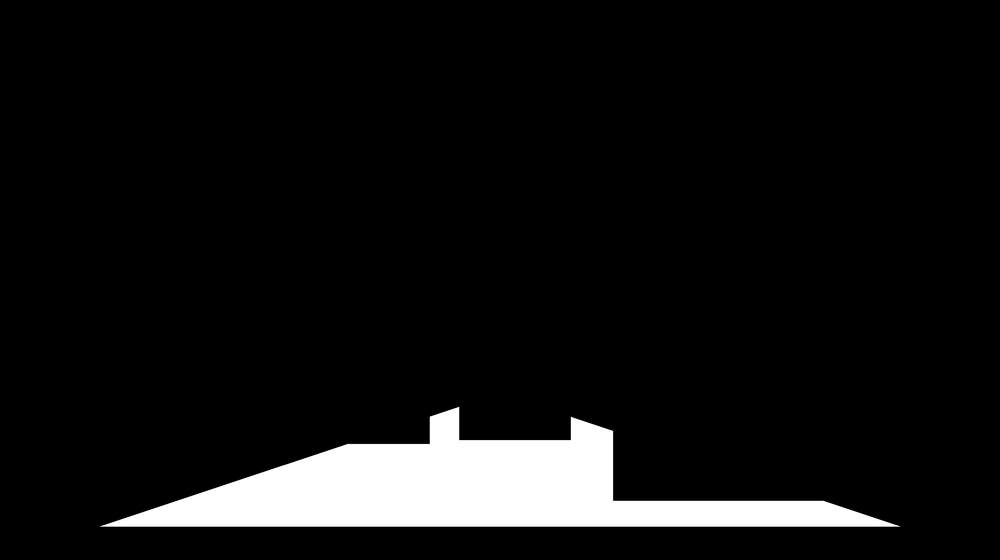

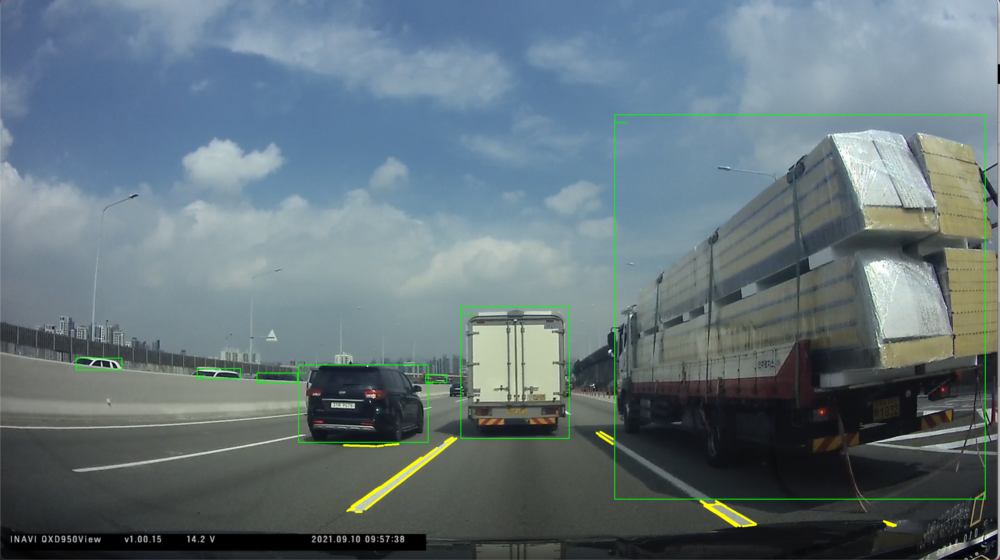

In [ ]:
detectAndLane(frame)